In [1]:
using Plots
using StatsBase
using Graphs
using GraphPlot
using GraphRecipes
using Random

# Lucas Schmidt Ferreira de Araujo

# Report 04

# Exercice I

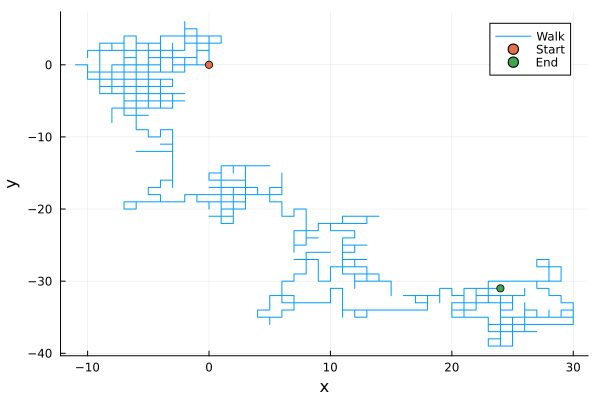

In [2]:

function random_walk(nt)
    Walk = zeros(nt,2)
    points = [(0, 1), (0, -1), (-1, 0), (1, 0)]    
    for q in 2:nt
        dx,dy = points[rand(1:4)]
        Walk[q,1] = Walk[q-1,1] + dx
        Walk[q,2] = Walk[q-1,2] + dy
    end
    return Walk
end

nt = 1000
Walk = random_walk(nt)
x = Walk[1:end,1]
y = Walk[1:end,2]

plot(x,y,label="Walk")
scatter!([x[1]],[y[1]],label="Start")
scatter!([x[end]],[y[end]],label="End")
xlabel!("x")
ylabel!("y")

┌ Info: Saved animation to /tmp/jl_O5SlA1Y7gX.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_O5SlA1Y7gX.gif")
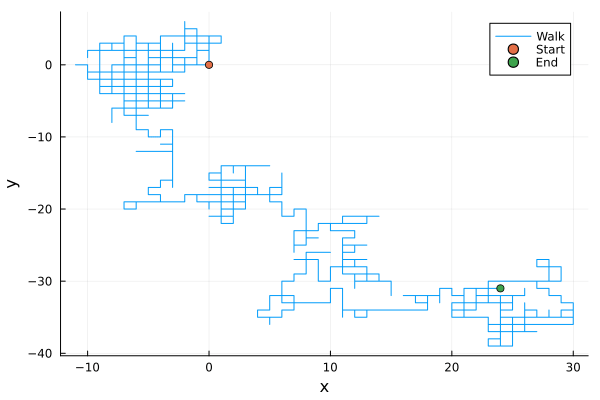

In [3]:
@gif for q in 1:Int(nt/10)
    plot!(x[1:q],y[1:q],label = false)
end

# Exercice II

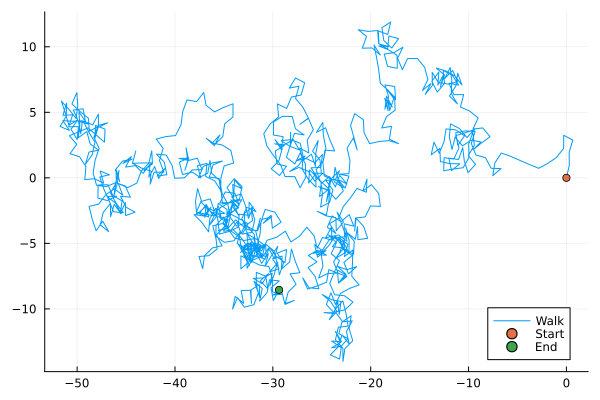

In [4]:
function pearson_random_walk(nt,a=1)
    Walk = zeros(nt,2)
    for q in 2:nt
        θ = 2 * π * rand()
        dx = a * cos(θ)
        dy = a * sin(θ)
        Walk[q,1] = Walk[q-1,1] + dx
        Walk[q,2] = Walk[q-1,2] + dy
    end
    return Walk
end
nt = 1000
Walk = pearson_random_walk(nt)
x = Walk[1:end,1]
y = Walk[1:end,2]

plot(x,y,label="Walk")
scatter!([x[1]],[y[1]],label="Start")
scatter!([x[end]],[y[end]],label="End")

In [5]:
nsim = 2000
nt = 1000
A = zeros(nt,nsim)
B = zeros(nt,nsim)
for q in 1:nsim
    Walk = pearson_random_walk(nt)
    x = Walk[1:end,1]
    y = Walk[1:end,2]
    A[1:end,q] .= x .> 0
    B[1:end,q] .= (x .> 0) .& (y .> 0)
end
println("Number of Simulations: $(nsim)")
println("Number of Iterations: $(nt)")

Number of Simulations: 2000
Number of Iterations: 1000


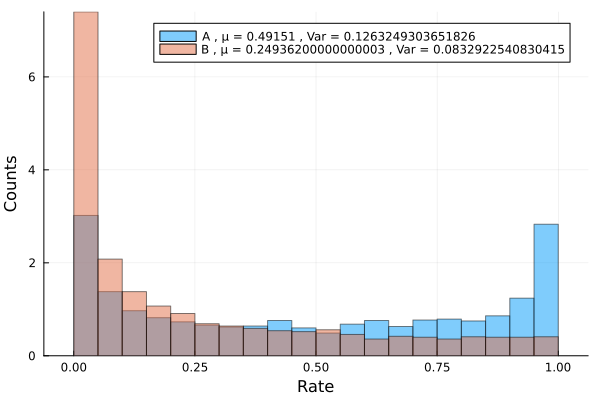

In [6]:
a = vec( sum(A, dims = 1) ) / nt
b = vec( sum(B, dims = 1) ) / nt
histogram( a , bins = 20,normalize=true,alpha=.5,label="A , μ = $(mean(a)) , Var = $(var(a))")
histogram!( b , bins = 20,normalize=true,alpha=.5,label="B , μ = $(mean(b)) , Var = $(var(b))")
ylabel!("Counts")
xlabel!("Rate")


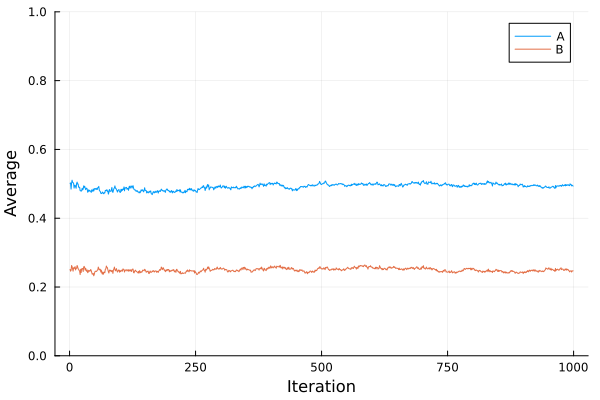

In [7]:
plot(sum(A[2:end,1:end],dims=2) / nsim , label = "A")
plot!(sum(B[2:end,1:end],dims=2) / nsim , label = "B")
ylims!(0,1)
xlabel!("Iteration")
ylabel!("Average")

In [8]:
kA = mean(sum(A[2:end,1:end],dims=2) / nsim)
kB = mean(sum(B[2:end,1:end],dims=2) / nsim)
println("<AN> = $(kA)")
println("<BN> = $(kB)")

<AN> = 0.49200200200200195
<BN> = 0.24961161161161163


# Exercice III

In [2]:
function walk_in_graph(G::Graph,n0::Int,nt)
    walk = zeros(Int,nt)
    walk[1] = n0
    for q in 2:nt
        walk[q] = rand(neighbors(G,walk[q-1]))
    end
    return walk
end

function simulate(nodes,nt,nsim,n0,G)
    freq = zeros(Int,nodes,nsim)
    for q in 1:nsim
        walk = walk_in_graph(G,n0,nt)
        for j in walk
            freq[j,q] += 1
        end
    end
    return freq
end

simulate (generic function with 1 method)

# Barabarsi Albert Graph

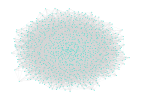

In [4]:
nodes = 1000    ### Number of nodes
k = 10          ### Number of connections 
nt = 1000       ### Number of iterations
nsim = 1000     ### Number of simulations
n0 = 5          ### Initial node
G = barabasi_albert(nodes, k)
freq = simulate(nodes,nt,nsim,n0,G)
gplot(G)

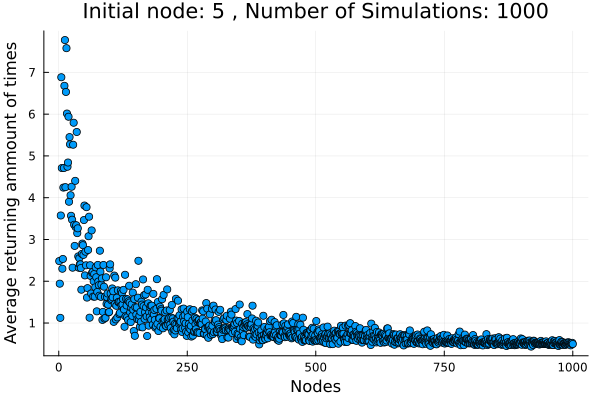

In [5]:
scatter([1:nodes],[mean(freq,dims = 2)],label=false)
xlabel!("Nodes")
ylabel!("Average returning ammount of times")
title!("Initial node: $(n0) , Number of Simulations: $(nsim)")

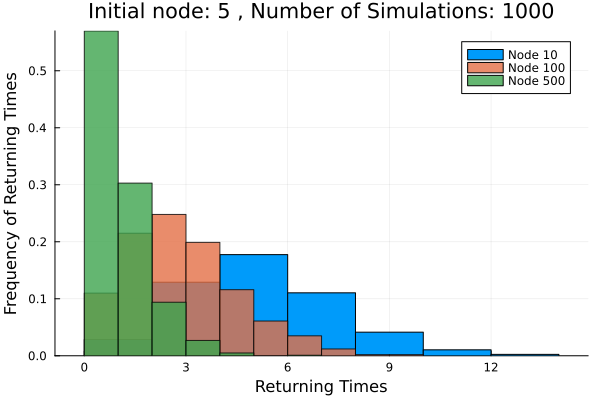

In [6]:
histogram(freq[10,1:end],normalized=true,bins=10 , label = "Node 10")
histogram!(freq[100,1:end],normalized=true,bins=10,alpha=.8 , label = "Node 100")
histogram!(freq[500,1:end],normalized=true,bins=10,alpha=.8 , label = "Node 500")
title!("Initial node: $(n0) , Number of Simulations: $(nsim)")
xlabel!("Returning Times")
ylabel!("Frequency of Returning Times")

┌ Info: Saved animation to /tmp/jl_NwxGDSlyDs.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_NwxGDSlyDs.gif")
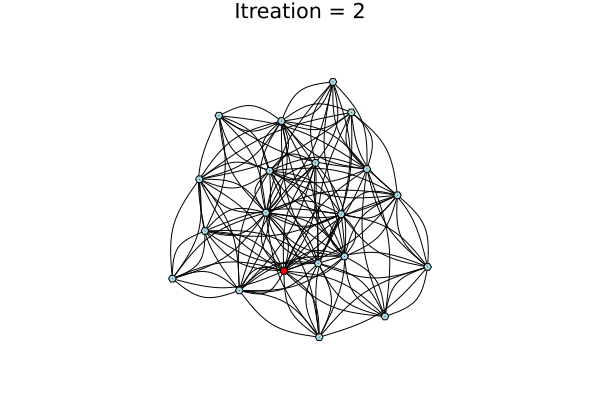

In [11]:
G = barabasi_albert(20, 5)
nt = 10
Walk = walk_in_graph(G,n0,nt)
node_colors = [:lightblue for j in 1:20]
node_colors[Walk[1]] = :red
plot(G, nodecolor=node_colors)
anim = @animate for q in 2:nt
    node_colors = [:lightblue for j in 1:20]
    node_colors[Walk[q]] = :red
    plot(G, nodecolor=node_colors,title="Itreation = $(q)")
end
gif(anim, fps=1)


# Watts Strogatz Graph

In [14]:
nodes = 1000     ### Number of nodes   
k = 100          ### Number of initial connection
β = .1           ### Probability of rewiring
nt = 1000        ### Number of iterations
nsim = 1000      ### Number of simulations
n0 = 5           ### Initial node
G = watts_strogatz(nodes, k, β)
freq = simulate(nodes,nt,nsim,n0,G)
gplot(G)

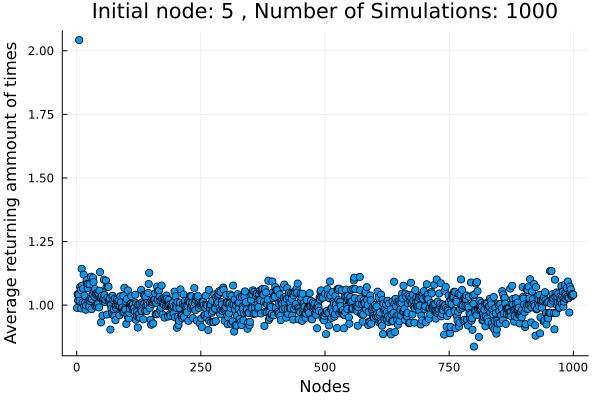

In [15]:
scatter([1:nodes],[mean(freq,dims = 2)],label=false)
xlabel!("Nodes")
ylabel!("Average returning ammount of times")
title!("Initial node: $(n0) , Number of Simulations: $(nsim)")

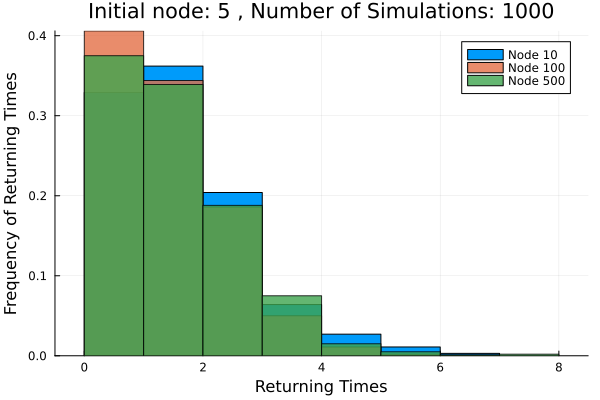

In [16]:
histogram(freq[10,1:end],normalized=true,bins=10 , label = "Node 10")
histogram!(freq[100,1:end],normalized=true,bins=10,alpha=.8 , label = "Node 100")
histogram!(freq[500,1:end],normalized=true,bins=10,alpha=.8 , label = "Node 500")
title!("Initial node: $(n0) , Number of Simulations: $(nsim)")
xlabel!("Returning Times")
ylabel!("Frequency of Returning Times")

┌ Info: Saved animation to /tmp/jl_ONGNgbQXOr.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_ONGNgbQXOr.gif")
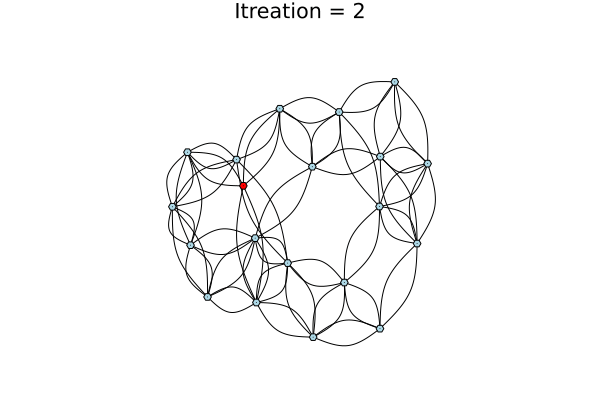

In [17]:
G = watts_strogatz(20, 5, β)
nt = 10
Walk = walk_in_graph(G,n0,nt)
node_colors = [:lightblue for j in 1:20]
node_colors[Walk[1]] = :red
plot(G, nodecolor=node_colors)
anim = @animate for q in 2:nt
    node_colors = [:lightblue for j in 1:20]
    node_colors[Walk[q]] = :red
    plot(G, nodecolor=node_colors,title="Itreation = $(q)")
end
gif(anim, fps=1)

# Random Graph

In [18]:
nodes = 1000     ### Number of nodes   
k = 100          ### Number of initial connection
β = 1            ### Probability of rewiring
nt = 1000        ### Number of iterations
nsim = 1000      ### Number of simulations
n0 = 100           ### Initial node
G = watts_strogatz(nodes, k, β)
freq = simulate(nodes,nt,nsim,n0,G)
gplot(G)

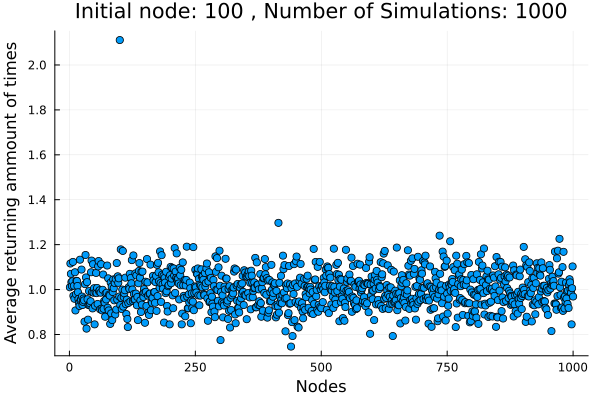

In [19]:
scatter([1:nodes],[mean(freq,dims = 2)],label=false)
xlabel!("Nodes")
ylabel!("Average returning ammount of times")
title!("Initial node: $(n0) , Number of Simulations: $(nsim)")

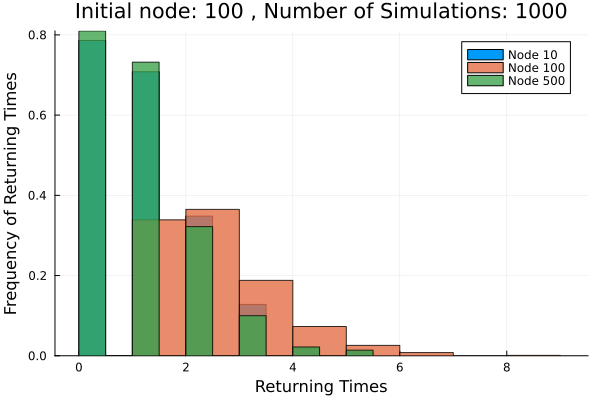

In [20]:
histogram(freq[10,1:end],normalized=true,bins=10 , label = "Node 10")
histogram!(freq[100,1:end],normalized=true,bins=10,alpha=.8 , label = "Node 100")
histogram!(freq[500,1:end],normalized=true,bins=10,alpha=.8 , label = "Node 500")
title!("Initial node: $(n0) , Number of Simulations: $(nsim)")
xlabel!("Returning Times")
ylabel!("Frequency of Returning Times")

┌ Info: Saved animation to /tmp/jl_wjSlKTs70z.gif
└ @ Plots /home/lucas/.julia/packages/Plots/a3u1v/src/animation.jl:156


Plots.AnimatedGif("/tmp/jl_wjSlKTs70z.gif")
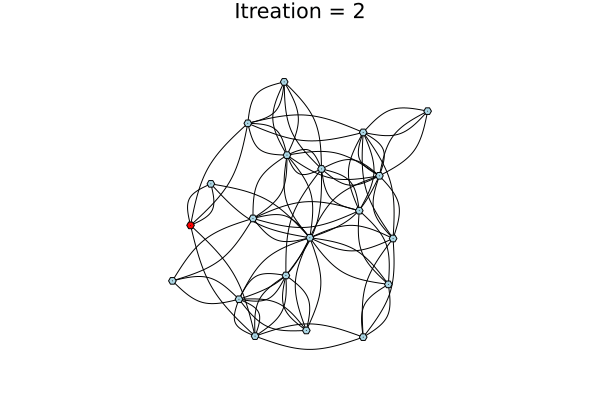

In [22]:
G = watts_strogatz(20, 5, 1)
nt = 10
Walk = walk_in_graph(G,1,nt)
node_colors = [:lightblue for j in 1:20]
node_colors[Walk[1]] = :red
plot(G, nodecolor=node_colors)
anim = @animate for q in 2:nt
    node_colors = [:lightblue for j in 1:nodes]
    node_colors[Walk[q]] = :red
    plot(G, nodecolor=node_colors,title="Itreation = $(q)")
end
gif(anim, fps=1)